# Домашнее задание  № 5. Матричные разложения/Тематическое моделирование

### Задание № 1 (8 баллов)

Попробуйте матричные разложения с 4 классификаторами - SGDClassifier, KNeighborsClassifier,  RandomForest, ExtraTreesClassifier (про него подробнее почитайте в документации, он похож на RF). Используйте и NMF, SVD и LDA. Сравните результаты на кросс-валидации и выберите лучшее сочетание.

В итоге у вас должно получиться, как минимум 12 моделей (три разложения на каждый классификатор). Используйте 1 и те же параметры кросс-валидации. Параметры векторизации, параметры K в матричных разложениях, параметры классификаторов могут быть разными между экспериментами.

Можете взять поменьше данных, если все будет обучаться слишком долго (не ставьте параметр K слишком большим в NMF и LDA, иначе точно будет слишком долго)

In [1]:
import warnings
warnings.filterwarnings("ignore")

In [2]:
import gensim
import pandas as pd
import numpy as np
from pymorphy3 import MorphAnalyzer
import pyLDAvis.gensim_models
from collections import Counter
from string import punctuation
from razdel import tokenize as razdel_tokenize

from sklearn.manifold import TSNE
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer, TfidfTransformer
from sklearn.metrics.pairwise import cosine_distances
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix

from sklearn.model_selection import KFold, StratifiedKFold
from matplotlib import pyplot as plt
import seaborn as sns
morph = MorphAnalyzer()

from sklearn.decomposition import TruncatedSVD, NMF, PCA, LatentDirichletAllocation

from sklearn.pipeline import Pipeline
from sklearn.linear_model import SGDClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier

In [3]:
def normalize(text):
    normalized_text = [word.text.strip(punctuation) for word \
                                                            in razdel_tokenize(text)]
    normalized_text = [word.lower() for word in normalized_text if word and len(word) < 20 ]
    normalized_text = [morph.parse(word)[0].normal_form for word in normalized_text]
    return ' '.join(normalized_text)

In [3]:
data = pd.read_csv('avito_category_classification.csv')
data['description_norm'] = data['description'].apply(normalize)

In [4]:
cv = CountVectorizer(tokenizer=lambda x: x.split(), min_df=5, max_df=0.1)
X_sparse = cv.fit_transform(data['description_norm'])

C:\Users\tohet\anaconda3\Lib\site-packages\sklearn\feature_extraction\text.py:525: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


In [10]:
svd = TruncatedSVD(800)
X_svd = svd.fit_transform(X_sparse)

In [16]:
sum(svd.explained_variance_ratio_)

0.8677289263017683

In [12]:
nmf = NMF(800)
X_nmf = nmf.fit_transform(X_sparse)

In [17]:
nmf.reconstruction_err_

216.75214826537814

In [15]:
lda = LatentDirichletAllocation(800)
X_lda = lda.fit_transform(X_sparse)

In [14]:
def eval_table(X, y, pipeline, N=6):
    # зафиксируем порядок классов
    labels = list(set(y))
    
    # метрики отдельных фолдов будет хранить в табличке
    fold_metrics = pd.DataFrame(index=labels)
    # дополнительно также соберем таблицу ошибок
    errors = np.zeros((len(labels), len(labels)))
    
    # создаем стратегию кросс-валидации
    # shuffle=True (перемешивание) - часто критично важно указать
    # т.к. данные могут быть упорядочены и модель на этом обучится
    kfold = StratifiedKFold(n_splits=N, shuffle=True)
    
    for i, (train_index, test_index) in enumerate(kfold.split(X, y)):
        # fit-predict как и раньше, но сразу пайплайном
        pipeline.fit(X[train_index], y[train_index])
        preds = pipeline.predict(X[test_index])
        
        # записываем метрику и индекс фолда
        fold_metrics[f'precision_{i}'] = precision_score(y[test_index], preds, labels=labels, average=None)
        fold_metrics[f'recall_{i}'] = recall_score(y[test_index], preds, labels=labels, average=None)
        fold_metrics[f'f1_{i}'] = f1_score(y[test_index], preds, labels=labels, average=None)
        errors += confusion_matrix(y[test_index], preds, labels=labels, normalize='true')
    
    # таблица для усредненных значений
    # тут мы берем колонки со значениями и усредняем их
    # часто также все метрики сразу суммируют и в конце просто делят на количество фолдов
    # но мы тут помимо среднего также хотим посмотреть на стандартное отклонение
    # чтобы понять как сильно варьируются оценки моделей
    result = pd.DataFrame(index=labels)
    result['precision'] = fold_metrics[[f'precision_{i}' for i in range(N)]].mean(axis=1).round(2)
    result['precision_std'] = fold_metrics[[f'precision_{i}' for i in range(N)]].std(axis=1).round(2)
    
    result['recall'] = fold_metrics[[f'recall_{i}' for i in range(N)]].mean(axis=1).round(2)
    result['recall_std'] = fold_metrics[[f'recall_{i}' for i in range(N)]].std(axis=1).round(2)
    
    result['f1'] = fold_metrics[[f'f1_{i}' for i in range(N)]].mean(axis=1).round(2)
    result['f1_std'] = fold_metrics[[f'f1_{i}' for i in range(N)]].std(axis=1).round(2)
    
    # добавим одну колонку со средним по всем классам
    result.loc['mean'] = result.mean().round(2)
    # проценты ошибок просто усредняем
    errors /= N
    
    return result, errors

# SVD

### SVD+SGD

In [30]:
pipeline_svd_sgd = Pipeline([
    ('bow', CountVectorizer(tokenizer=lambda x: x.split(), ngram_range=(1,2), min_df=5, max_df=0.4)),
    ('svd', svd),
    ('clf', SGDClassifier(max_iter = 2000, learning_rate = 'optimal'))
])

In [31]:
metrics_svd_sgd, errors_svd_sgd = eval_table(data['description_norm'], data['category_name'], pipeline_svd_sgd)

In [32]:
metrics_svd_sgd

,precision,precision_std,recall,recall_std,f1,f1_std
Мебель и интерьер,0.72,0.04,0.65,0.08,0.68,0.04
Предложение услуг,0.77,0.06,0.75,0.06,0.76,0.05
Детская одежда и обувь,0.76,0.03,0.77,0.02,0.76,0.01
"Одежда, обувь, аксессуары",0.70,0.03,0.79,0.03,0.74,0.02
Товары для детей и игрушки,0.76,0.05,0.65,0.03,0.70,0.03
Ремонт и строительство,0.64,0.06,0.53,0.04,0.58,0.04
Телефоны,0.83,0.04,0.80,0.04,0.82,0.03
Автомобили,0.87,0.07,0.89,0.03,0.88,0.04
Бытовая техника,0.65,0.08,0.54,0.08,0.58,0.05
Квартиры,0.96,0.02,0.96,0.01,0.96,0.01


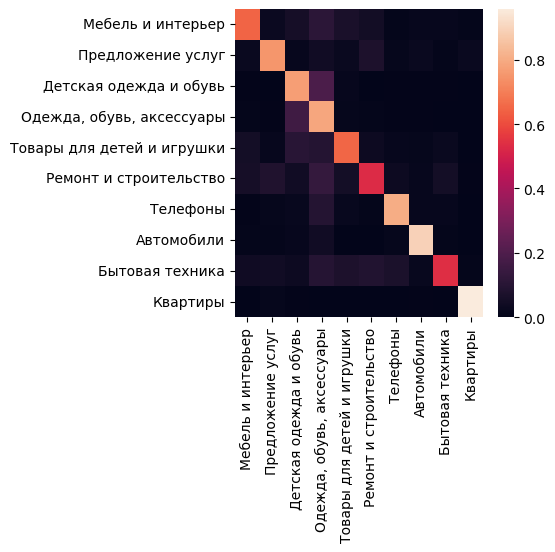

In [33]:
plt.figure(figsize=(4, 4))
sns.heatmap(errors_svd_sgd, xticklabels=metrics_svd_sgd.index.tolist()[:-1], 
            yticklabels=metrics_svd_sgd.index.tolist()[:-1])
plt.show()

### SVD+KNeighbors

In [64]:
pipeline_svd_kn = Pipeline([
    ('bow', CountVectorizer(tokenizer=lambda x: x.split(), ngram_range=(1,2), min_df=5, max_df=0.4)),
    ('svd', svd),
    ('clf', KNeighborsClassifier(n_neighbors = 10, leaf_size = 100))
])

In [65]:
metrics_svd_kn, errors_svd_kn = eval_table(data['description_norm'], data['category_name'], pipeline_svd_kn)

In [66]:
metrics_svd_kn

,precision,precision_std,recall,recall_std,f1,f1_std
Мебель и интерьер,0.40,0.09,0.21,0.02,0.28,0.04
Предложение услуг,0.57,0.06,0.58,0.04,0.58,0.04
Детская одежда и обувь,0.47,0.02,0.63,0.05,0.54,0.01
"Одежда, обувь, аксессуары",0.48,0.03,0.62,0.03,0.54,0.02
Товары для детей и игрушки,0.48,0.03,0.26,0.03,0.34,0.02
Ремонт и строительство,0.28,0.09,0.16,0.05,0.20,0.05
Телефоны,0.65,0.14,0.30,0.06,0.40,0.05
Автомобили,0.56,0.05,0.54,0.04,0.55,0.04
Бытовая техника,0.41,0.09,0.27,0.07,0.33,0.08
Квартиры,0.97,0.01,0.67,0.04,0.79,0.03


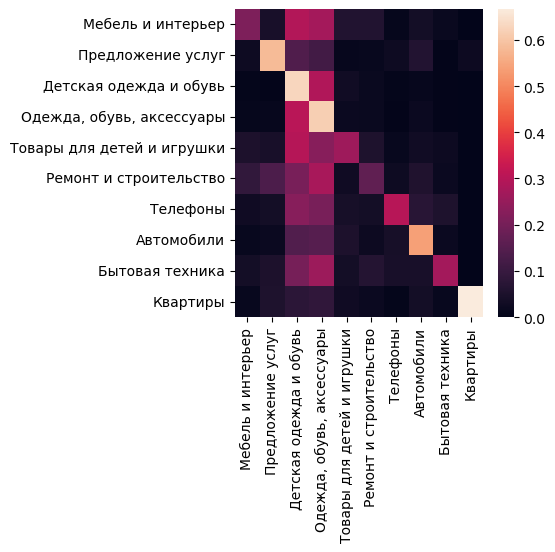

In [67]:
plt.figure(figsize=(4, 4))
sns.heatmap(errors_svd_kn, xticklabels=metrics_svd_kn.index.tolist()[:-1], 
            yticklabels=metrics_svd_kn.index.tolist()[:-1])
plt.show()

### SVD+RandomForest

In [85]:
pipeline_svd_rf = Pipeline([
    ('bow', CountVectorizer(tokenizer=lambda x: x.split(), ngram_range=(1,2), min_df=5, max_df=0.4)),
    ('svd', svd),
    ('clf', RandomForestClassifier(criterion = 'log_loss', class_weight = 'balanced'))
])

In [86]:
metrics_svd_rf, errors_svd_rf = eval_table(data['description_norm'], data['category_name'], pipeline_svd_rf)

In [87]:
metrics_svd_rf

,precision,precision_std,recall,recall_std,f1,f1_std
Мебель и интерьер,0.61,0.22,0.08,0.02,0.14,0.04
Предложение услуг,0.81,0.07,0.44,0.07,0.56,0.05
Детская одежда и обувь,0.43,0.01,0.67,0.04,0.52,0.02
"Одежда, обувь, аксессуары",0.45,0.02,0.69,0.01,0.54,0.01
Товары для детей и игрушки,0.67,0.07,0.17,0.04,0.26,0.06
Ремонт и строительство,0.60,0.17,0.10,0.02,0.17,0.04
Телефоны,0.86,0.08,0.36,0.07,0.51,0.08
Автомобили,0.83,0.05,0.56,0.06,0.67,0.05
Бытовая техника,0.43,0.14,0.13,0.06,0.20,0.08
Квартиры,0.89,0.02,0.89,0.03,0.89,0.02


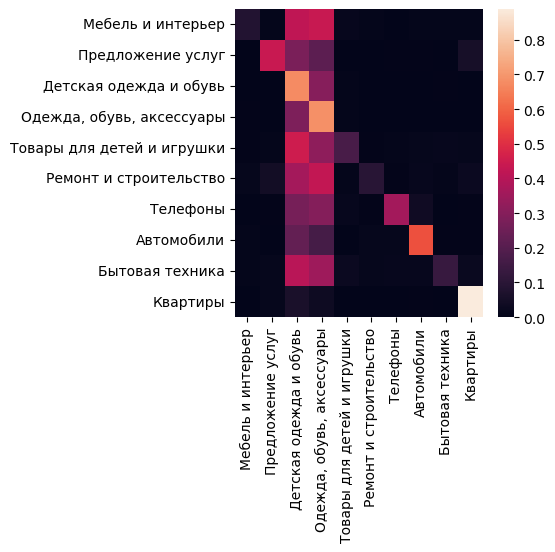

In [88]:
plt.figure(figsize=(4, 4))
sns.heatmap(errors_svd_rf, xticklabels=metrics_svd_rf.index.tolist()[:-1], 
            yticklabels=metrics_svd_rf.index.tolist()[:-1])
plt.show()

### SVD+ExtraTrees

In [98]:
pipeline_svd_et = Pipeline([
    ('bow', CountVectorizer(tokenizer=lambda x: x.split(), ngram_range=(1,2), min_df=5, max_df=0.4)),
    ('svd', svd),
    ('clf', ExtraTreesClassifier(n_estimators = 200, criterion = 'log_loss', class_weight = 'balanced'))
])

In [99]:
metrics_svd_et, errors_svd_et = eval_table(data['description_norm'], data['category_name'], pipeline_svd_et)

In [100]:
metrics_svd_et

,precision,precision_std,recall,recall_std,f1,f1_std
Мебель и интерьер,0.61,0.12,0.08,0.03,0.15,0.04
Предложение услуг,0.86,0.10,0.12,0.04,0.21,0.06
Детская одежда и обувь,0.39,0.02,0.68,0.03,0.50,0.02
"Одежда, обувь, аксессуары",0.42,0.02,0.70,0.02,0.52,0.02
Товары для детей и игрушки,0.49,0.11,0.08,0.02,0.14,0.04
Ремонт и строительство,0.59,0.22,0.08,0.05,0.14,0.08
Телефоны,0.82,0.05,0.20,0.04,0.33,0.05
Автомобили,0.80,0.10,0.26,0.04,0.39,0.05
Бытовая техника,0.44,0.08,0.14,0.02,0.21,0.03
Квартиры,0.70,0.04,0.63,0.05,0.66,0.05


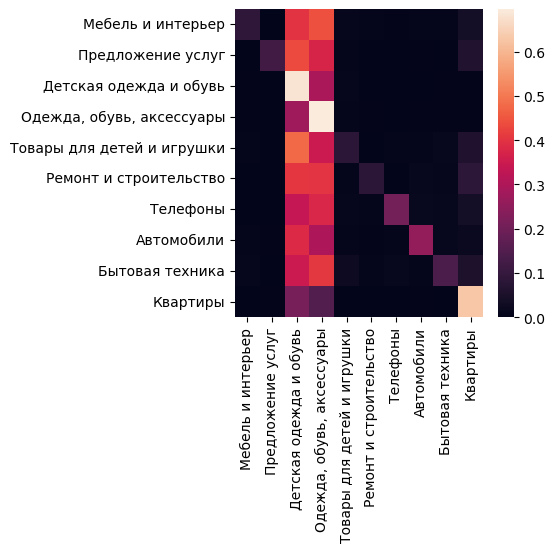

In [101]:
plt.figure(figsize=(4, 4))
sns.heatmap(errors_svd_et, xticklabels=metrics_svd_et.index.tolist()[:-1], 
            yticklabels=metrics_svd_et.index.tolist()[:-1])
plt.show()

# NMF

### NMF+SGD

NMF со значением K более 100 просто отказывался работать. 

In [42]:
pipeline_nmf_sgd = Pipeline([
    ('bow', CountVectorizer(tokenizer=lambda x: x.split(), ngram_range=(1,2), min_df=5, max_df=0.4)),
    ('nmf', NMF(200)),
    ('clf', SGDClassifier(max_iter = 2000, learning_rate = 'optimal'))
])

In [43]:
metrics_nmf_sgd, errors_nmf_sgd = eval_table(data['description_norm'], data['category_name'], pipeline_nmf_sgd)

In [44]:
metrics_nmf_sgd

,precision,precision_std,recall,recall_std,f1,f1_std
Мебель и интерьер,0.53,0.20,0.19,0.11,0.24,0.12
Предложение услуг,0.60,0.09,0.57,0.13,0.57,0.04
Детская одежда и обувь,0.64,0.14,0.63,0.10,0.61,0.04
"Одежда, обувь, аксессуары",0.57,0.07,0.63,0.07,0.60,0.03
Товары для детей и игрушки,0.61,0.21,0.52,0.15,0.52,0.07
Ремонт и строительство,0.55,0.16,0.21,0.11,0.28,0.10
Телефоны,0.63,0.20,0.62,0.18,0.58,0.08
Автомобили,0.80,0.04,0.65,0.14,0.71,0.09
Бытовая техника,0.47,0.33,0.16,0.20,0.14,0.05
Квартиры,0.80,0.16,0.92,0.04,0.85,0.10


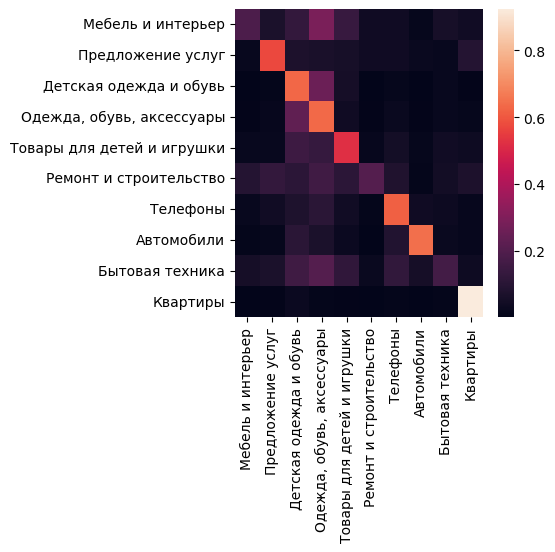

In [45]:
plt.figure(figsize=(4, 4))
sns.heatmap(errors_nmf_sgd, xticklabels=metrics_nmf_sgd.index.tolist()[:-1], 
            yticklabels=metrics_nmf_sgd.index.tolist()[:-1])
plt.show()

### NMF+KNeighbors

In [75]:
pipeline_nmf_kn = Pipeline([
    ('bow', CountVectorizer(tokenizer=lambda x: x.split(), ngram_range=(1,2), min_df=5, max_df=0.4)),
    ('nmf', NMF(100)),
    ('clf', KNeighborsClassifier(n_neighbors = 5, leaf_size = 30))
])

In [76]:
metrics_nmf_kn, errors_nmf_kn = eval_table(data['description_norm'], data['category_name'], pipeline_nmf_kn)

In [77]:
metrics_nmf_kn

,precision,precision_std,recall,recall_std,f1,f1_std
Мебель и интерьер,0.26,0.04,0.18,0.02,0.21,0.03
Предложение услуг,0.53,0.06,0.49,0.07,0.50,0.04
Детская одежда и обувь,0.45,0.03,0.59,0.03,0.51,0.03
"Одежда, обувь, аксессуары",0.45,0.02,0.53,0.03,0.49,0.02
Товары для детей и игрушки,0.41,0.09,0.21,0.04,0.27,0.05
Ремонт и строительство,0.33,0.13,0.14,0.07,0.20,0.08
Телефоны,0.62,0.12,0.35,0.06,0.44,0.08
Автомобили,0.44,0.04,0.55,0.09,0.49,0.05
Бытовая техника,0.22,0.08,0.17,0.04,0.19,0.04
Квартиры,0.89,0.04,0.78,0.03,0.83,0.02


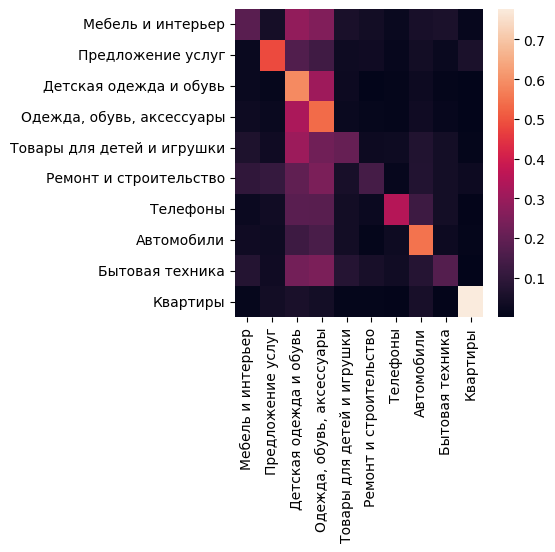

In [78]:
plt.figure(figsize=(4, 4))
sns.heatmap(errors_nmf_kn, xticklabels=metrics_nmf_kn.index.tolist()[:-1], 
            yticklabels=metrics_nmf_kn.index.tolist()[:-1])
plt.show()

### NMF+RandomForest

In [89]:
pipeline_nmf_rf = Pipeline([
    ('bow', CountVectorizer(tokenizer=lambda x: x.split(), ngram_range=(1,2), min_df=5, max_df=0.4)),
    ('nmf', NMF(100)),
    ('clf', RandomForestClassifier(criterion = 'log_loss', class_weight = 'balanced'))
])

In [90]:
metrics_nmf_rf, errors_nmf_rf = eval_table(data['description_norm'], data['category_name'], pipeline_nmf_rf)

In [91]:
metrics_nmf_rf

,precision,precision_std,recall,recall_std,f1,f1_std
Мебель и интерьер,0.65,0.05,0.47,0.04,0.54,0.04
Предложение услуг,0.69,0.03,0.71,0.05,0.70,0.03
Детская одежда и обувь,0.68,0.02,0.69,0.03,0.68,0.01
"Одежда, обувь, аксессуары",0.61,0.02,0.74,0.02,0.67,0.01
Товары для детей и игрушки,0.64,0.04,0.52,0.06,0.57,0.04
Ремонт и строительство,0.56,0.06,0.37,0.06,0.44,0.06
Телефоны,0.75,0.05,0.74,0.04,0.74,0.04
Автомобили,0.75,0.04,0.85,0.04,0.80,0.03
Бытовая техника,0.47,0.16,0.22,0.05,0.30,0.07
Квартиры,0.92,0.03,0.94,0.03,0.93,0.02


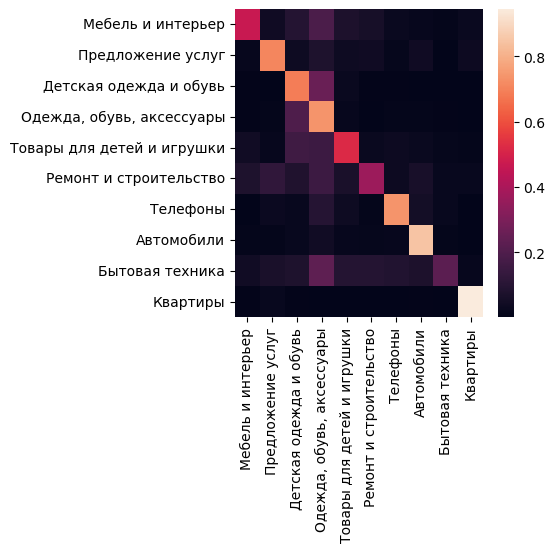

In [92]:
plt.figure(figsize=(4, 4))
sns.heatmap(errors_nmf_rf, xticklabels=metrics_nmf_rf.index.tolist()[:-1], 
            yticklabels=metrics_nmf_rf.index.tolist()[:-1])
plt.show()

### NMF+ExtraTrees

In [102]:
pipeline_nmf_et = Pipeline([
    ('bow', CountVectorizer(tokenizer=lambda x: x.split(), ngram_range=(1,2), min_df=5, max_df=0.4)),
    ('nmf', NMF(100)),
    ('clf', ExtraTreesClassifier(n_estimators = 100, criterion = 'log_loss', class_weight = 'balanced'))
])

In [103]:
metrics_nmf_et, errors_nmf_et = eval_table(data['description_norm'], data['category_name'], pipeline_nmf_et)

In [104]:
metrics_nmf_et

,precision,precision_std,recall,recall_std,f1,f1_std
Мебель и интерьер,0.61,0.09,0.40,0.07,0.48,0.07
Предложение услуг,0.70,0.06,0.76,0.05,0.73,0.05
Детская одежда и обувь,0.64,0.03,0.70,0.02,0.67,0.02
"Одежда, обувь, аксессуары",0.60,0.02,0.71,0.03,0.65,0.02
Товары для детей и игрушки,0.65,0.06,0.50,0.03,0.56,0.03
Ремонт и строительство,0.60,0.03,0.38,0.07,0.46,0.06
Телефоны,0.78,0.06,0.72,0.06,0.75,0.05
Автомобили,0.76,0.04,0.86,0.05,0.80,0.04
Бытовая техника,0.44,0.08,0.19,0.02,0.26,0.03
Квартиры,0.93,0.01,0.96,0.01,0.94,0.01


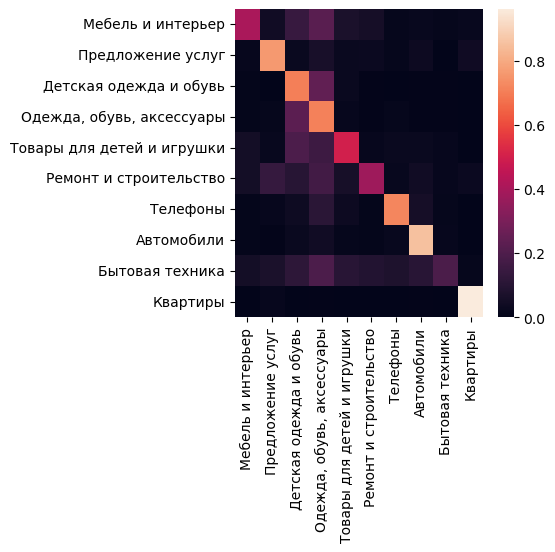

In [105]:
plt.figure(figsize=(4, 4))
sns.heatmap(errors_nmf_et, xticklabels=metrics_nmf_et.index.tolist()[:-1], 
            yticklabels=metrics_nmf_et.index.tolist()[:-1])
plt.show()

# LDA

### LDA+SGD

In [48]:
pipeline_lda_sgd = Pipeline([
    ('bow', CountVectorizer(tokenizer=lambda x: x.split(), ngram_range=(1,2), min_df=5, max_df=0.4)),
    ('lda', LatentDirichletAllocation(200)),
    ('clf', SGDClassifier(max_iter = 2000, learning_rate = 'optimal'))
])

In [49]:
metrics_lda_sgd, errors_lda_sgd = eval_table(data['description_norm'], data['category_name'], pipeline_lda_sgd)

In [50]:
metrics_lda_sgd

,precision,precision_std,recall,recall_std,f1,f1_std
Мебель и интерьер,0.53,0.08,0.29,0.12,0.35,0.10
Предложение услуг,0.60,0.11,0.73,0.08,0.65,0.05
Детская одежда и обувь,0.61,0.05,0.65,0.07,0.62,0.01
"Одежда, обувь, аксессуары",0.58,0.03,0.69,0.07,0.63,0.01
Товары для детей и игрушки,0.61,0.06,0.49,0.06,0.54,0.03
Ремонт и строительство,0.51,0.12,0.17,0.12,0.23,0.11
Телефоны,0.74,0.13,0.69,0.10,0.70,0.05
Автомобили,0.75,0.06,0.85,0.03,0.79,0.03
Бытовая техника,0.57,0.17,0.13,0.09,0.20,0.11
Квартиры,0.87,0.03,0.97,0.01,0.91,0.02


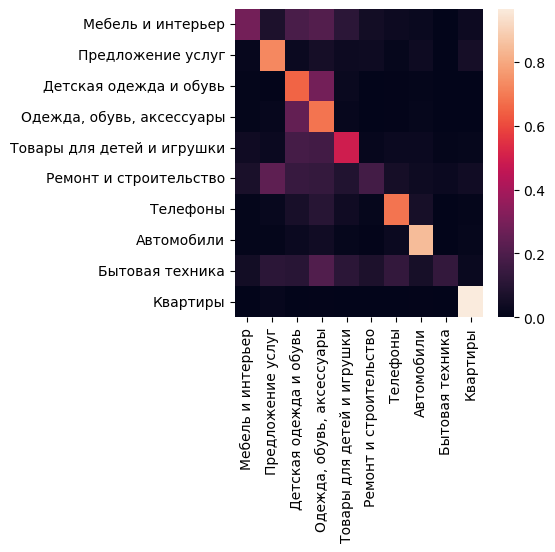

In [51]:
plt.figure(figsize=(4, 4))
sns.heatmap(errors_lda_sgd, xticklabels=metrics_lda_sgd.index.tolist()[:-1], 
            yticklabels=metrics_lda_sgd.index.tolist()[:-1])
plt.show()

### LDA+KNeighbors

In [81]:
pipeline_lda_kn = Pipeline([
    ('bow', CountVectorizer(tokenizer=lambda x: x.split(), ngram_range=(1,2), min_df=5, max_df=0.4)),
    ('lda', LatentDirichletAllocation(100)),
    ('clf', KNeighborsClassifier(n_neighbors = 5, leaf_size = 30))
])

In [82]:
metrics_lda_kn, errors_lda_kn = eval_table(data['description_norm'], data['category_name'], pipeline_lda_kn)

In [83]:
metrics_lda_kn

,precision,precision_std,recall,recall_std,f1,f1_std
Мебель и интерьер,0.43,0.07,0.25,0.02,0.32,0.03
Предложение услуг,0.71,0.05,0.55,0.05,0.62,0.05
Детская одежда и обувь,0.47,0.04,0.68,0.04,0.55,0.03
"Одежда, обувь, аксессуары",0.52,0.03,0.49,0.04,0.51,0.03
Товары для детей и игрушки,0.65,0.09,0.36,0.06,0.47,0.06
Ремонт и строительство,0.34,0.08,0.14,0.04,0.19,0.05
Телефоны,0.59,0.17,0.55,0.07,0.56,0.07
Автомобили,0.66,0.09,0.85,0.04,0.74,0.05
Бытовая техника,0.32,0.07,0.24,0.04,0.27,0.05
Квартиры,0.92,0.02,0.95,0.02,0.93,0.01


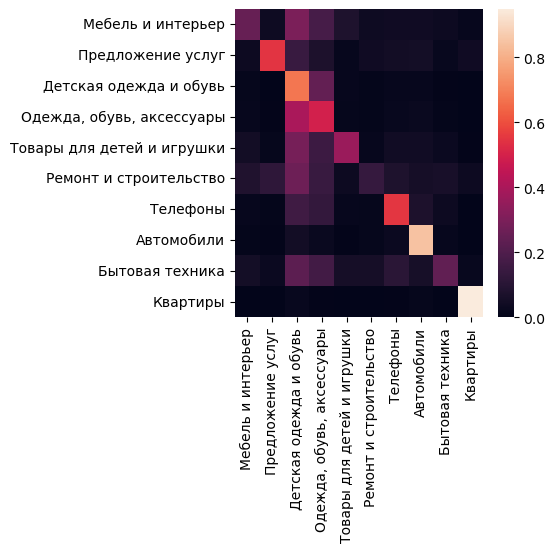

In [84]:
plt.figure(figsize=(4, 4))
sns.heatmap(errors_lda_kn, xticklabels=metrics_lda_kn.index.tolist()[:-1], 
            yticklabels=metrics_lda_kn.index.tolist()[:-1])
plt.show()

### LDA+RandomForest

In [93]:
pipeline_lda_rf = Pipeline([
    ('bow', CountVectorizer(tokenizer=lambda x: x.split(), ngram_range=(1,2), min_df=5, max_df=0.4)),
    ('lda', LatentDirichletAllocation(100)),
    ('clf', RandomForestClassifier(criterion = 'log_loss', class_weight = 'balanced'))
])

In [94]:
metrics_lda_rf, errors_lda_rf = eval_table(data['description_norm'], data['category_name'], pipeline_lda_rf)

In [95]:
metrics_lda_rf

,precision,precision_std,recall,recall_std,f1,f1_std
Мебель и интерьер,0.39,0.07,0.20,0.08,0.26,0.08
Предложение услуг,0.65,0.04,0.63,0.05,0.64,0.04
Детская одежда и обувь,0.53,0.03,0.61,0.04,0.57,0.03
"Одежда, обувь, аксессуары",0.50,0.02,0.57,0.01,0.53,0.01
Товары для детей и игрушки,0.53,0.06,0.44,0.03,0.48,0.03
Ремонт и строительство,0.38,0.10,0.18,0.05,0.24,0.07
Телефоны,0.66,0.08,0.59,0.08,0.62,0.07
Автомобили,0.71,0.06,0.82,0.03,0.76,0.03
Бытовая техника,0.29,0.09,0.15,0.07,0.20,0.08
Квартиры,0.82,0.03,0.94,0.01,0.88,0.02


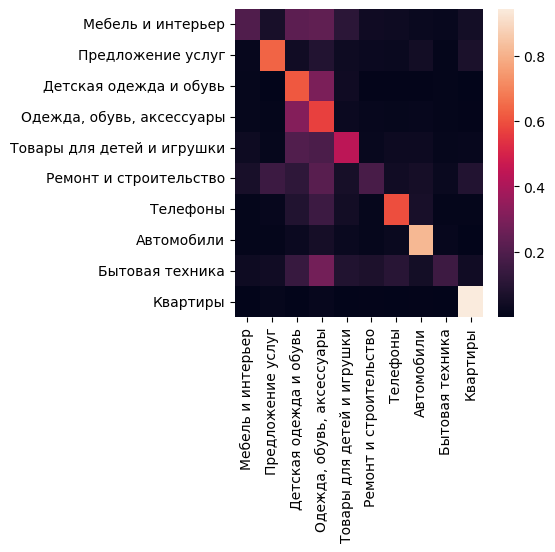

In [96]:
plt.figure(figsize=(4, 4))
sns.heatmap(errors_lda_rf, xticklabels=metrics_lda_rf.index.tolist()[:-1], 
            yticklabels=metrics_lda_rf.index.tolist()[:-1])
plt.show()

### LDA+ExtraTrees

In [106]:
pipeline_lda_et = Pipeline([
    ('bow', CountVectorizer(tokenizer=lambda x: x.split(), ngram_range=(1,2), min_df=5, max_df=0.4)),
    ('lda', LatentDirichletAllocation(100)),
    ('clf', ExtraTreesClassifier(n_estimators = 100, criterion = 'log_loss', class_weight = 'balanced'))
])

In [107]:
metrics_lda_et, errors_lda_et = eval_table(data['description_norm'], data['category_name'], pipeline_lda_et)

In [108]:
metrics_lda_et

,precision,precision_std,recall,recall_std,f1,f1_std
Мебель и интерьер,0.44,0.07,0.28,0.10,0.34,0.09
Предложение услуг,0.65,0.03,0.64,0.04,0.65,0.03
Детская одежда и обувь,0.57,0.03,0.63,0.02,0.60,0.02
"Одежда, обувь, аксессуары",0.52,0.03,0.59,0.03,0.55,0.03
Товары для детей и игрушки,0.58,0.04,0.44,0.04,0.50,0.04
Ремонт и строительство,0.40,0.07,0.24,0.06,0.29,0.05
Телефоны,0.69,0.05,0.68,0.04,0.68,0.03
Автомобили,0.73,0.04,0.83,0.03,0.78,0.02
Бытовая техника,0.32,0.10,0.17,0.04,0.22,0.05
Квартиры,0.86,0.03,0.96,0.02,0.90,0.01


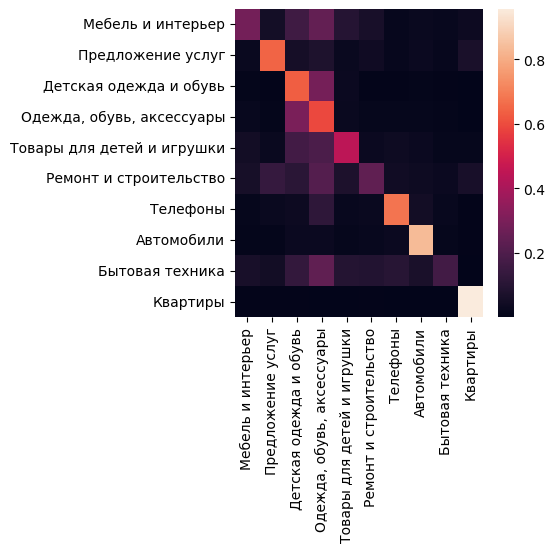

In [109]:
plt.figure(figsize=(4, 4))
sns.heatmap(errors_lda_et, xticklabels=metrics_lda_et.index.tolist()[:-1], 
            yticklabels=metrics_lda_et.index.tolist()[:-1])
plt.show()

#### Вывод:
Наиболее качественные результаты дала самая первая модель: SVD+SGD. Она единственная дала показатели precision, recall и f1 выше 0,7. Кроме того, эта модель оказалась быстрее всех остальных. Близко по качеству результатов к ней подощла NMF+RandomForest, стабильно дававшая три показателя на уровне 0,62-0,67. Но она работает слишком долго, чтобы приравнивать её к SVD+SGD.

### Задание № 2 (2 балла)

С помощью gensim постройте 5 тематических моделей с разными параметрами. Как минимум попробуйте: разное количество тем, alpha и eta параметры (в альфа попробуйте "asymmetric" и "auto" помимо 'symmetric' по дефолту, в eta просто попробуйте разные значения), а также разные параметры фильтрации словаря. 

Оцените каждую из моделей с помощью метрик (перплексии и когерентности), а также визуально, просмотрев получаемые темы. Найдите самую хорошую тему для каждой из моделей.

In [4]:
with open('wiki_data.txt', 'r', encoding='utf-8') as fil:
    texts = fil.read().splitlines()[:5000]
texts = ([normalize(text) for text in texts])

### Модель 1

In [5]:
dictinary = gensim.corpora.Dictionary((text.split() for text in texts))
dictinary.filter_extremes(no_above=0.1, no_below=10) # не меняем параметры фильтрации
dictinary.compactify()

In [6]:
corpus = [dictinary.doc2bow(text.split()) for text in texts]

In [7]:
lda = gensim.models.LdaModel(corpus, 100, alpha='asymmetric', id2word=dictinary, passes=10, eta = 'auto')

In [8]:
pyLDAvis.enable_notebook()

In [9]:
pyLDAvis.gensim_models.prepare(lda, corpus, dictinary)

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
22     0.090307  0.196663       1        1  4.774848
95    -0.027473  0.217451       2        1  3.699404
0     -0.076308  0.109854       3        1  3.312045
75    -0.153042  0.062072       4        1  2.806514
80     0.084143  0.054411       5        1  2.781431
...         ...       ...     ...      ...       ...
70     0.108769 -0.059113      96        1  0.175381
99     0.061073 -0.101907      97        1  0.173861
54     0.108415 -0.050150      98        1  0.171481
79     0.125983 -0.043968      99        1  0.126503
66     0.117975 -0.030335     100        1  0.079153

[100 rows x 5 columns], topic_info=             Term         Freq        Total  Category  logprob  loglift
116        остров  1181.000000  1181.000000   Default  30.0000  30.0000
701          уезд  1221.000000  1221.000000   Default  29.0000  29.0000
6536  житомирский   989.000000   989.000000   Default  28.0000  28.0000
3245       летний   918.000000   918.000000   Default  27.0000  27.0000
1171        армия  1232.000000  1232.000000   Default  26.0000  26.0000
...           ...          ...          ...       ...      ...      ...
1823   установить     3.556721   404.601686  Topic100  -4.9379   2.4075
740      активный     2.873752   216.230976  Topic100  -5.1512   2.8208
2217    сотрудник     2.743824   199.120057  Topic100  -5.1974   2.8570
1994        вести     2.655047   291.005368  Topic100  -5.2303   2.4447
1074      степень     2.278842   420.436821  Topic100  -5.3831   1.9239

[5293 rows x 6 columns], token_table=      Topic      Freq Term
term                      
705       8  0.641777    0
705      11  0.054044    0
705      21  0.040533    0
705      41  0.033778    0
705      78  0.216177    0
...     ...       ...  ...
533      60  0.037035    №
533      72  0.041865    №
533      75  0.148139    №
533      82  0.014492    №
533      94  0.011271    №

[23461 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[23, 96, 1, 76, 81, 86, 26, 8, 14, 53, 56, 9, 93, 36, 94, 91, 74, 33, 83, 16, 44, 19, 84, 58, 72, 20, 70, 5, 95, 78, 3, 31, 24, 69, 90, 42, 62, 64, 27, 77, 60, 79, 52, 10, 21, 66, 12, 63, 29, 97, 87, 4, 35, 22, 50, 18, 32, 40, 54, 7, 2, 39, 45, 15, 88, 92, 49, 89, 59, 25, 98, 82, 28, 46, 37, 38, 6, 85, 51, 41, 34, 11, 65, 47, 68, 30, 61, 43, 75, 73, 57, 99, 17, 48, 13, 71, 100, 55, 80, 67])

In [10]:
topics = []
for topic_id, topic in lda.show_topics(num_topics=100, formatted=False):
    topic = [word for word, _ in topic]
    topics.append(topic)

In [11]:
np.exp2(-lda.log_perplexity(corpus[:1000]))

607.8852972327827

In [12]:
coherence_model_lda = gensim.models.CoherenceModel(topics=topics, 
                                                   texts=[text.split() for text in texts], 
                                                   dictionary=dictinary, coherence='c_v')

In [13]:
coherence_model_lda.get_coherence()

0.5513404503916159

### Модель 2

In [14]:
dictinary = gensim.corpora.Dictionary((text.split() for text in texts))
dictinary.filter_extremes(no_above=0.5, no_below=20) # пробуем другие параметры фильтрации
dictinary.compactify()

In [15]:
corpus = [dictinary.doc2bow(text.split()) for text in texts]

In [16]:
lda2 = gensim.models.LdaModel(corpus, 100, alpha='auto', id2word=dictinary, passes=20, eta = 'symmetric')

In [17]:
pyLDAvis.enable_notebook()

In [18]:
pyLDAvis.gensim_models.prepare(lda2, corpus, dictinary)

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
70     0.216666 -0.068557       1        1  7.004624
83     0.201101 -0.090484       2        1  5.601101
84     0.191177 -0.061368       3        1  5.433829
35     0.198736 -0.097087       4        1  5.248050
92     0.209472 -0.094234       5        1  4.995290
...         ...       ...     ...      ...       ...
44    -0.174935 -0.096992      96        1  0.036179
33    -0.174282 -0.096827      97        1  0.031907
36    -0.173822 -0.099814      98        1  0.031694
15    -0.153615 -0.122292      99        1  0.017537
77    -0.123895 -0.137224     100        1  0.009326

[100 rows x 5 columns], topic_info=          Term          Freq         Total  Category  logprob  loglift
17           «  16245.000000  16245.000000   Default  30.0000  30.0000
18           »  16239.000000  16239.000000   Default  29.0000  29.0000
25        быть  14823.000000  14823.000000   Default  28.0000  28.0000
82       район   2690.000000   2690.000000   Default  27.0000  27.0000
335         он   9769.000000   9769.000000   Default  26.0000  26.0000
...        ...           ...           ...       ...      ...      ...
1521  компания      0.008058    857.902856  Topic100  -9.1913  -2.2955
117     первый      0.008058   3456.824816  Topic100  -9.1913  -3.6891
133        для      0.008058   4618.807943  Topic100  -9.1913  -3.9789
31         где      0.008058   1430.968784  Topic100  -9.1913  -2.8071
148        это      0.008058   3789.384814  Topic100  -9.1913  -3.7810

[4904 rows x 6 columns], token_table=      Topic      Freq Term
term                      
707       6  0.665075    0
707       9  0.040308    0
707      11  0.040308    0
707      44  0.033590    0
707      90  0.214974    0
...     ...       ...  ...
549      55  0.003158    №
549      57  0.022104    №
549      58  0.269983    №
549      67  0.033156    №
549      74  0.044208    №

[19122 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[71, 84, 85, 36, 93, 43, 99, 31, 61, 12, 2, 52, 67, 65, 72, 13, 76, 56, 98, 48, 54, 25, 53, 73, 28, 35, 40, 70, 86, 38, 23, 42, 44, 26, 50, 9, 22, 49, 10, 79, 60, 19, 46, 51, 20, 57, 11, 68, 63, 100, 32, 90, 17, 82, 3, 74, 91, 96, 39, 29, 92, 88, 6, 24, 30, 83, 55, 77, 41, 94, 59, 58, 87, 80, 14, 62, 75, 64, 5, 8, 18, 15, 66, 95, 21, 69, 7, 89, 97, 1, 33, 47, 81, 4, 27, 45, 34, 37, 16, 78])

In [19]:
topics = []
for topic_id, topic in lda2.show_topics(num_topics=100, formatted=False):
    topic = [word for word, _ in topic]
    topics.append(topic)

In [20]:
np.exp2(-lda2.log_perplexity(corpus[:1000]))

205.1486132164627

In [21]:
coherence_model_lda2 = gensim.models.CoherenceModel(topics=topics, 
                                                   texts=[text.split() for text in texts], 
                                                   dictionary=dictinary, coherence='c_v')

In [22]:
coherence_model_lda2.get_coherence()

0.5106448018811421

### Модель 3

In [23]:
dictinary = gensim.corpora.Dictionary((text.split() for text in texts))
dictinary.filter_extremes(no_above=0.1, no_below=10) # не меняем параметры фильтрации
dictinary.compactify()

In [24]:
corpus = [dictinary.doc2bow(text.split()) for text in texts]

In [25]:
lda_mc = gensim.models.LdaMulticore(corpus, 200, id2word=dictinary, passes=20, eta = 'symmetric') # пробуем LdaMulticore 

In [26]:
pyLDAvis.enable_notebook()

In [27]:
pyLDAvis.gensim_models.prepare(lda_mc, corpus, dictinary)

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
160   -0.077623  0.072584       1        1  3.124082
34    -0.100739  0.153264       2        1  2.259377
26    -0.035573 -0.046219       3        1  2.254945
4      0.154076 -0.188308       4        1  2.015916
134    0.111799 -0.062418       5        1  1.656567
...         ...       ...     ...      ...       ...
135   -0.021169  0.068068     196        1  0.116275
49     0.031731 -0.043307     197        1  0.115941
179    0.002478 -0.024654     198        1  0.114603
190   -0.003624  0.023550     199        1  0.105613
143    0.080139  0.007599     200        1  0.104960

[200 rows x 5 columns], topic_info=              Term         Freq        Total  Category  logprob  loglift
701           уезд  1115.000000  1115.000000   Default  30.0000  30.0000
6536   житомирский   887.000000   887.000000   Default  29.0000  29.0000
116         остров  1051.000000  1051.000000   Default  28.0000  28.0000
3245        летний   803.000000   803.000000   Default  27.0000  27.0000
1097   университет   828.000000   828.000000   Default  26.0000  26.0000
...            ...          ...          ...       ...      ...      ...
567   американский     4.111477   548.271251  Topic200  -5.0752   1.9664
769         вместе     4.165711   768.033946  Topic200  -5.0621   1.6424
1044           сей     3.719661   123.162887  Topic200  -5.1753   3.3595
127     российский     3.955398   785.275660  Topic200  -5.1139   1.5684
787          выход     3.783379   218.225841  Topic200  -5.1583   2.8044

[10570 rows x 6 columns], token_table=      Topic      Freq Term
term                      
705       8  0.232582    0
705      18  0.026581    0
705      19  0.265808    0
705      21  0.013290    0
705      28  0.059807    0
...     ...       ...  ...
533     175  0.016359    №
533     176  0.003272    №
533     180  0.014723    №
533     182  0.004908    №
533     195  0.001636    №

[100788 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[161, 35, 27, 5, 135, 198, 119, 3, 20, 194, 156, 58, 1, 19, 6, 126, 93, 56, 73, 177, 195, 147, 154, 46, 71, 123, 92, 70, 41, 142, 51, 182, 109, 54, 86, 57, 44, 199, 100, 190, 176, 155, 34, 105, 17, 127, 167, 183, 146, 124, 200, 122, 42, 11, 4, 88, 102, 162, 68, 66, 69, 31, 30, 184, 36, 82, 120, 178, 12, 53, 107, 74, 28, 159, 160, 10, 33, 118, 84, 166, 131, 189, 18, 150, 38, 75, 45, 115, 63, 137, 16, 98, 138, 192, 133, 157, 116, 163, 171, 40, 140, 158, 143, 181, 8, 48, 89, 110, 43, 132, 164, 141, 128, 2, 96, 24, 152, 94, 145, 179, 117, 148, 125, 114, 108, 175, 62, 173, 76, 174, 72, 52, 111, 103, 9, 188, 95, 113, 80, 101, 197, 139, 121, 130, 87, 61, 172, 26, 59, 23, 170, 97, 193, 99, 186, 81, 187, 60, 49, 169, 79, 104, 37, 151, 15, 90, 106, 153, 64, 196, 32, 77, 168, 55, 83, 112, 14, 85, 21, 13, 39, 29, 165, 134, 78, 149, 91, 22, 65, 129, 25, 185, 47, 7, 67, 136, 50, 180, 191, 144])

In [28]:
topics = []
for topic_id, topic in lda_mc.show_topics(num_topics=100, formatted=False):
    topic = [word for word, _ in topic]
    topics.append(topic)

In [29]:
np.exp2(-lda_mc.log_perplexity(corpus[:1000]))

6721.868536067142

In [30]:
coherence_model_lda_mc = gensim.models.CoherenceModel(topics=topics, 
                                                   texts=[text.split() for text in texts], 
                                                   dictionary=dictinary, coherence='c_v')

In [31]:
coherence_model_lda_mc.get_coherence()

0.5196221905226048

### Модель 4

In [32]:
dictinary = gensim.corpora.Dictionary((text.split() for text in texts))
dictinary.filter_extremes(no_above=0.5, no_below=30) # пробуем ещё параметры фильтрации
dictinary.compactify()

In [33]:
corpus = [dictinary.doc2bow(text.split()) for text in texts]

In [34]:
lda3 = gensim.models.LdaModel(corpus, 200, alpha='asymmetric', id2word=dictinary, passes=15, eta = 'auto')

In [35]:
pyLDAvis.enable_notebook()

In [36]:
pyLDAvis.gensim_models.prepare(lda3, corpus, dictinary)

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
18     0.260451 -0.128935       1        1  7.773251
6      0.255148 -0.138425       2        1  5.538172
178    0.250746 -0.039701       3        1  3.844800
66     0.270376 -0.047437       4        1  3.006621
49     0.141138 -0.024937       5        1  2.605111
...         ...       ...     ...      ...       ...
139   -0.139912 -0.077827     196        1  0.015044
166   -0.120845 -0.106923     197        1  0.013825
131   -0.116723 -0.111223     198        1  0.011313
46     0.019668 -0.156812     199        1  0.003636
174    0.019667 -0.156812     200        1  0.001162

[200 rows x 5 columns], topic_info=       Term          Freq         Total  Category  logprob  loglift
16        »  16441.000000  16441.000000   Default   30.000  30.0000
15        «  16450.000000  16450.000000   Default   29.000  29.0000
23     быть  14688.000000  14688.000000   Default   28.000  28.0000
310      он   9770.000000   9770.000000   Default   27.000  27.0000
253    игра   2152.000000   2152.000000   Default   26.000  26.0000
..      ...           ...           ...       ...      ...      ...
46      как      0.002744   3939.497149  Topic200   -8.125  -2.8146
234      до      0.002744   3494.409958  Topic200   -8.125  -2.6947
549     она      0.002744   2054.618389  Topic200   -8.125  -2.1636
113  первый      0.002744   3438.775143  Topic200   -8.125  -2.6786
159     или      0.002744   2019.885330  Topic200   -8.125  -2.1466

[9085 rows x 6 columns], token_table=      Topic      Freq Term
term                      
632       9  0.119665    0
632      11  0.053184    0
632      13  0.631563    0
632     126  0.166201    0
632     127  0.019944    0
...     ...       ...  ...
499      67  0.057240    №
499      68  0.027030    №
499      83  0.001590    №
499      94  0.034980    №
499     138  0.467457    №

[27468 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[19, 7, 179, 67, 50, 18, 138, 192, 37, 168, 97, 88, 107, 77, 180, 14, 181, 116, 110, 118, 29, 197, 91, 79, 23, 53, 188, 95, 154, 120, 33, 165, 20, 112, 111, 178, 200, 177, 39, 117, 191, 152, 60, 131, 31, 83, 13, 159, 9, 199, 57, 36, 17, 12, 155, 195, 22, 139, 75, 144, 122, 52, 182, 134, 44, 72, 11, 15, 127, 49, 108, 170, 119, 160, 187, 198, 102, 54, 174, 128, 151, 141, 106, 156, 25, 70, 30, 121, 55, 142, 8, 93, 21, 28, 166, 158, 35, 150, 135, 194, 73, 114, 46, 115, 147, 16, 10, 71, 193, 145, 113, 76, 32, 123, 68, 100, 146, 124, 164, 126, 84, 78, 184, 2, 105, 99, 171, 94, 148, 101, 59, 103, 48, 64, 5, 74, 183, 27, 186, 109, 1, 189, 125, 173, 51, 63, 96, 129, 161, 81, 90, 133, 98, 56, 162, 58, 82, 136, 26, 38, 196, 185, 6, 4, 40, 89, 24, 69, 43, 130, 87, 3, 153, 172, 92, 85, 157, 104, 62, 34, 86, 163, 41, 137, 66, 169, 190, 149, 45, 143, 176, 65, 80, 42, 61, 140, 167, 132, 47, 175])

In [37]:
topics = []
for topic_id, topic in lda3.show_topics(num_topics=100, formatted=False):
    topic = [word for word, _ in topic]
    topics.append(topic)

In [38]:
np.exp2(-lda3.log_perplexity(corpus[:1000]))

203.254311003991

In [39]:
coherence_model_lda3 = gensim.models.CoherenceModel(topics=topics, 
                                                   texts=[text.split() for text in texts], 
                                                   dictionary=dictinary, coherence='c_v')

In [40]:
coherence_model_lda3.get_coherence()

0.499548435676264

### Модель 5

In [41]:
dictinary = gensim.corpora.Dictionary((text.split() for text in texts))
dictinary.filter_extremes(no_above=0.4, no_below=30) # пробуем ещё параметры фильтрации
dictinary.compactify()

In [42]:
corpus = [dictinary.doc2bow(text.split()) for text in texts]

In [44]:
lda_mc2 = gensim.models.LdaMulticore(corpus, 300, id2word=dictinary, passes=25, eta = 'auto')

In [45]:
pyLDAvis.enable_notebook()

In [46]:
pyLDAvis.gensim_models.prepare(lda_mc2, corpus, dictinary)

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
218    0.218099  0.107446       1        1  4.828741
110    0.221041 -0.067075       2        1  3.365348
99     0.145404  0.070466       3        1  2.217727
67     0.023107 -0.179457       4        1  1.934431
299    0.146200 -0.044787       5        1  1.909027
...         ...       ...     ...      ...       ...
204    0.041622 -0.038149     296        1  0.052243
228   -0.147595 -0.033923     297        1  0.049182
12    -0.052567 -0.074500     298        1  0.049008
209    0.007393  0.002752     299        1  0.044449
244   -0.014799  0.052920     300        1  0.040639

[300 rows x 5 columns], topic_info=         Term         Freq        Total  Category  logprob  loglift
306        он  9891.000000  9891.000000   Default  30.0000  30.0000
249      игра  2171.000000  2171.000000   Default  29.0000  29.0000
74      район  2687.000000  2687.000000   Default  28.0000  28.0000
1168        г  1828.000000  1828.000000   Default  27.0000  27.0000
80       село  1819.000000  1819.000000   Default  26.0000  26.0000
...       ...          ...          ...       ...      ...      ...
107         о     3.299494  2978.567317  Topic300  -4.5164   1.0028
78       свой     3.425374  4355.160387  Topic300  -4.4789   0.6603
1168        г     3.049183  1828.965215  Topic300  -4.5953   1.4116
40          к     3.100224  5391.747336  Topic300  -4.5787   0.3470
45    который     2.997588  6087.687674  Topic300  -4.6123   0.1920

[15557 rows x 6 columns], token_table=      Topic      Freq Term
term                      
628       1  0.052598    0
628       4  0.512828    0
628      12  0.013149    0
628      21  0.111770    0
628      25  0.006575    0
...     ...       ...  ...
495     233  0.001628    №
495     261  0.004884    №
495     271  0.003256    №
495     273  0.011396    №
495     277  0.004884    №

[99783 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[219, 111, 100, 68, 300, 140, 239, 270, 67, 194, 3, 274, 251, 167, 262, 5, 7, 203, 244, 241, 84, 121, 106, 171, 224, 160, 151, 79, 73, 189, 221, 250, 61, 178, 187, 81, 138, 75, 141, 23, 271, 44, 148, 25, 120, 190, 263, 45, 181, 288, 202, 200, 289, 220, 256, 66, 59, 11, 12, 157, 163, 292, 89, 172, 62, 222, 214, 217, 20, 299, 82, 117, 78, 35, 150, 30, 294, 136, 26, 102, 107, 96, 99, 249, 43, 22, 201, 199, 85, 24, 276, 186, 286, 128, 287, 144, 130, 74, 1, 18, 212, 36, 193, 17, 185, 173, 182, 282, 218, 243, 93, 56, 298, 142, 170, 191, 237, 51, 28, 143, 34, 208, 278, 146, 264, 21, 19, 216, 226, 52, 16, 265, 132, 139, 254, 228, 257, 188, 118, 15, 31, 149, 155, 280, 207, 211, 259, 164, 53, 76, 174, 116, 97, 183, 69, 39, 209, 134, 283, 159, 129, 230, 29, 169, 63, 50, 126, 154, 291, 258, 94, 113, 184, 48, 57, 279, 233, 147, 124, 32, 88, 176, 46, 91, 14, 87, 161, 168, 234, 267, 77, 252, 281, 275, 231, 122, 290, 86, 71, 246, 225, 284, 105, 206, 38, 175, 83, 247, 177, 101, 55, 41, 9, 133, 260, 158, 108, 70, 297, 232, 119, 131, 261, 266, 166, 145, 269, 114, 112, 215, 42, 109, 204, 8, 195, 58, 255, 49, 268, 213, 240, 37, 272, 127, 162, 115, 296, 60, 152, 135, 40, 277, 6, 33, 98, 192, 104, 165, 54, 92, 227, 80, 10, 223, 153, 110, 180, 238, 125, 2, 27, 248, 198, 72, 123, 293, 95, 285, 4, 242, 179, 295, 156, 65, 235, 90, 64, 273, 253, 236, 197, 103, 47, 196, 137, 205, 229, 13, 210, 245])

In [47]:
topics = []
for topic_id, topic in lda_mc2.show_topics(num_topics=100, formatted=False):
    topic = [word for word, _ in topic]
    topics.append(topic)

In [48]:
np.exp2(-lda_mc2.log_perplexity(corpus[:1000]))

1012.6415784701072

In [49]:
coherence_model_lda_mc2 = gensim.models.CoherenceModel(topics=topics, 
                                                   texts=[text.split() for text in texts], 
                                                   dictionary=dictinary, coherence='c_v')

In [50]:
coherence_model_lda3.get_coherence()

0.47846970983931747

#### Вывод:
Неплохие результаты дала Модель 1 (100 тем, alpha='auto', passes=20, eta = 'symmetric'). У неё самый высокий показатель coherence - 0,55. Также визуально она гораздо меньше дркгих моделей создаёт клубки из тем. Тем не менее, здесь может несколько смутить перплексия в 607.
В данном случае гораздо лучше себя проявила Модель 2 (100 тем, alpha='auto', passes=20, eta='symmetric'). У неё перплексия почти в три раза меньше - 205. Тем не менее, она создает больше клубков тем, и её coherence немного меньше - 0,51. 